# Convolutional Neural Network practice

In [3]:
# Dog/Cat image classification. We only have images. Let us create labels first.
import os

cat = os.listdir("training_set/cats")
dog = os.listdir("training_set/dogs")

In [12]:
cat.remove(cat[0]) #remove the extra unwanted file in the directory

In [14]:
dog.remove(dog[0]) # remove the extra unwanted file in the directory 

In [67]:
import pandas as pd
label_df = pd.DataFrame(dog, columns=['filename'])

In [68]:
df2 = pd.DataFrame(cat, columns=['filename'])

In [69]:
label_df = label_df.append(df2, ignore_index=True)

In [70]:
# Create the labels based on the name of the file
label_df['label'] = label_df['filename'].map(lambda x: "dog" if x[:3] == "dog" else "cat")

In [71]:
label_df['label'].value_counts()

cat    4000
dog    4000
Name: label, dtype: int64

In [75]:
label_df.to_csv("training_set/Labels.csv")

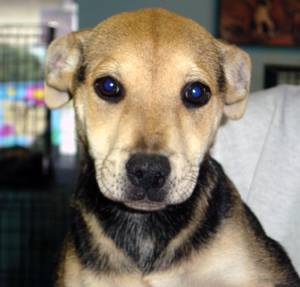

In [85]:
from IPython.display import display, Image
Image("C:/Users/mail2/OneDrive/Desktop/Practice/Kaggle/Deep learning/training_set/dogs/dog.4.jpg")

In [1]:
image_path = "C:/Users/mail2/OneDrive/Desktop/Practice/Kaggle/Deep learning/training_set/dogs/dog.5.jpg"

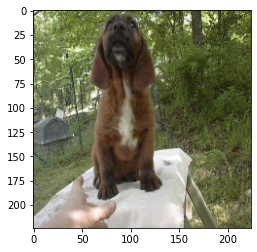

In [3]:
import tensorflow as tf
import matplotlib.pyplot as plt
image = tf.io.read_file(image_path)
image = tf.image.decode_jpeg(image, channels=3)
image = tf.image.convert_image_dtype(image, tf.float32)
image = tf.image.resize(image, [224, 224])
plt.imshow(image)

In [14]:
image = tf.io.read_file("training_set/dogs/dog.6.jpg")
image = tf.image.decode_jpeg(image, channels=3)
image = tf.image.convert_image_dtype(image, tf.float32)
image = tf.image.resize(image, [224, 224])

# Let us do some set up before building the model

In [6]:
# Let us start by importing the required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
%matplotlib inline

In [8]:
# Extract the labels first
labels_df = pd.read_csv("training_set/Labels.csv")
labels_df.drop(labels_df.columns[0],axis=1,inplace=True)
labels_df = labels_df.sample(frac=1)
labels_df

,filename,label
2612,dog.335.jpg,dog
1,dog.10.jpg,dog
786,dog.1706.jpg,dog
3814,dog.831.jpg,dog
1327,dog.2193.jpg,dog
...,...,...
1641,dog.2476.jpg,dog
4828,cat.1744.jpg,cat
1291,dog.2160.jpg,dog
6981,cat.3682.jpg,cat


In [9]:
# Get all the filenames and store it in a list
filenames = ["training_set/dogs_cats/" + fname for fname in labels_df['filename']]

In [14]:
# Create a function to process the image
IMG_SIZE = 224

def process_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, [IMG_SIZE, IMG_SIZE])
    return image

In [15]:
# Create a function to return the processed image and label together
def get_image_label(image_path, label):
    image = process_image(image_path)
    return image, label

In [12]:
# Use Labelencoding to encode the labels as integers
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
int_labels = le.fit_transform(labels_df['label'])

In [16]:
# Create a function to build batches of images with the standard size 32
BATCH_SIZE = 32

def create_data_batches(x, y=None, test_data=False, valid_data=False, batch_size=BATCH_SIZE):
    if test_data:
        print("Creating test batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x)))
        data_batch = data.map(process_image).batch(batch_size)
    elif valid_data:
        print("Creating Validation batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                                   tf.constant(y)))
        data_batch = data.map(get_image_label).batch(batch_size)
    else:
        print("Creating training batches..")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                                   tf.constant(y)))
        data = data.shuffle(buffer_size=len(x))
        data_batch = data.map(get_image_label).batch(batch_size)
    return data_batch

In [14]:
#Assign X & y and split the data into test and training set.
X = filenames
y = int_labels

# NUM_IMAGES = 100

from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, 
                                                      y, 
                                                      test_size=0.2, 
                                                      random_state=42)

In [15]:
len(X_train), len(y_train), len(X_valid), len(y_valid)

(6400, 6400, 1600, 1600)

In [16]:
X_train[:5], y_train[:5]

(['training_set/dogs_cats/cat.1109.jpg',
  'training_set/dogs_cats/cat.904.jpg',
  'training_set/dogs_cats/dog.880.jpg',
  'training_set/dogs_cats/dog.3807.jpg',
  'training_set/dogs_cats/cat.3074.jpg'],
 array([0, 0, 1, 1, 0]))

In [17]:
# Get the training data and labels
train_data = create_data_batches(X_train, y_train)
valid_data = create_data_batches(X_valid, y_valid, valid_data=True)

Creating training batches..
Creating Validation batches...


In [18]:
train_data.element_spec, valid_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None,), dtype=tf.int32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None,), dtype=tf.int32, name=None)))

In [17]:
# Create a function to get which animal it is based on the labels
def get_label_name(int_label):
    if int_label == 1:
        return 'Dog'
    else:
        return 'Cat'

In [18]:
# Create a function to show all the images in a batch
def show_all_images(images, labels, n_rows, n_cols):
    plt.figure(figsize=(n_cols*5, 5*n_rows))
    for i in range(32):
        plt.subplot(n_rows, n_cols, i+1)
        plt.imshow(images[i])
        plt.title(get_label_name(labels[i]),fontsize=25)
        plt.tight_layout()

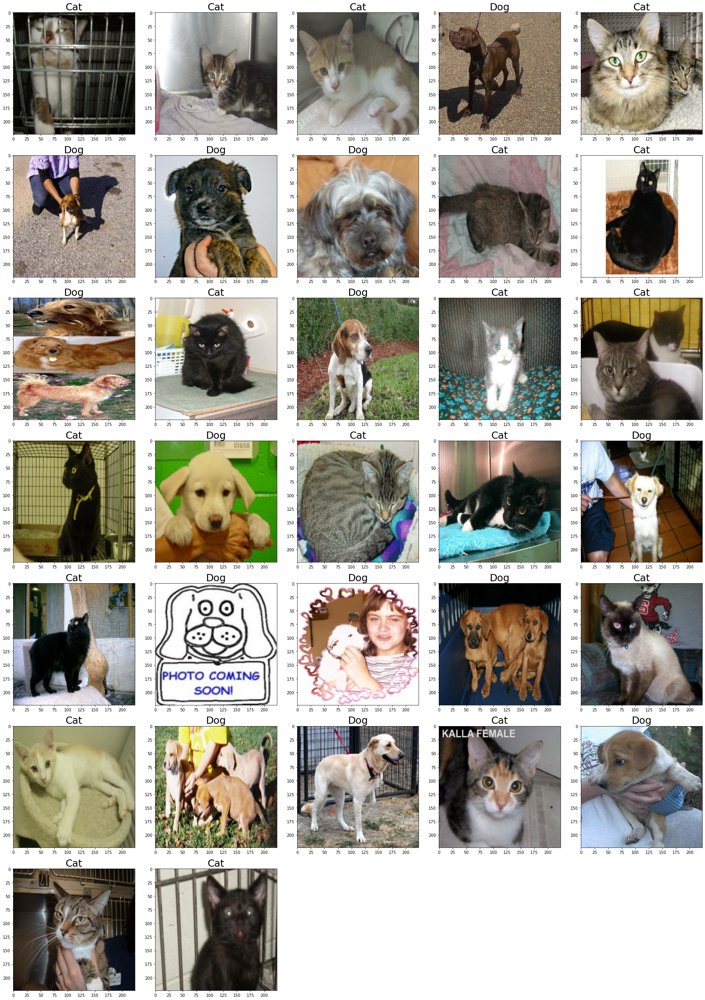

In [21]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_all_images(train_images, train_labels, 7, 5)

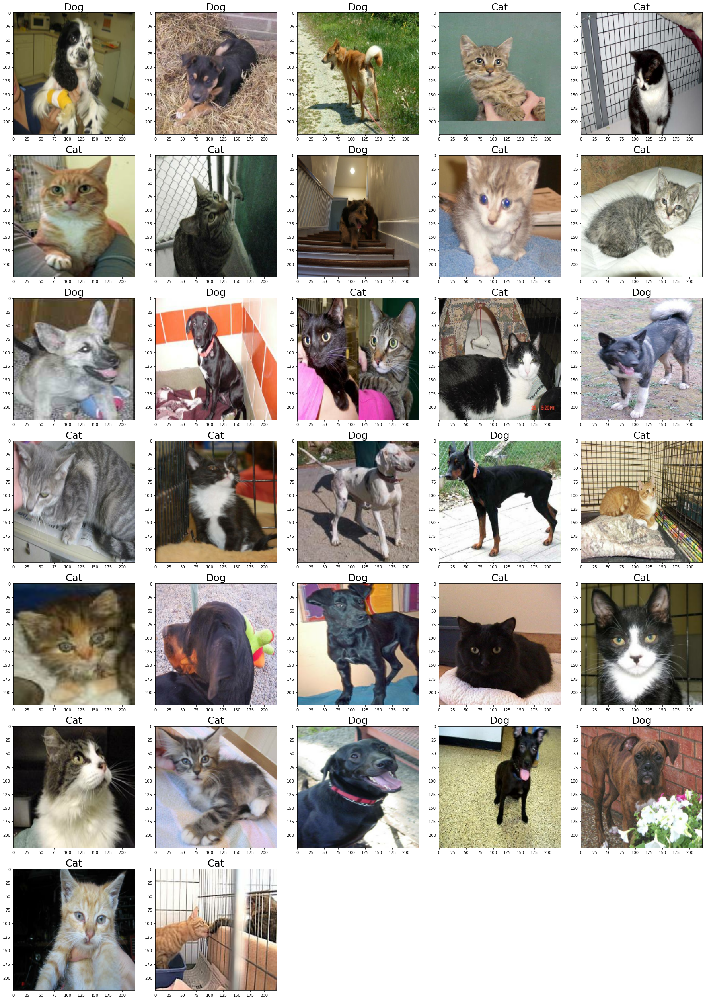

In [22]:
valid_images, valid_labels = next(valid_data.as_numpy_iterator())
show_all_images(valid_images, valid_labels, 7, 5)

In [23]:
# Let us start creating the model
INPUT_SHAPE = [IMG_SIZE, IMG_SIZE, 3]
OUTPUT_SHAPE = 1
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE):
    # Initialize CNN
    cnn_model = tf.keras.models.Sequential()
    
    # Add the convoluted layer
    cnn_model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation="relu", input_shape=input_shape))
    
    # Max Pooling
    cnn_model.add(tf.keras.layers.MaxPool2D(pool_size=2, strides=2))
    
    # Add another convoluted layer
    cnn_model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation="relu"))
    cnn_model.add(tf.keras.layers.MaxPool2D(pool_size=2, strides=2))
    
    # Flatten
    cnn_model.add(tf.keras.layers.Flatten())
    
    # Fully connected layer
    cnn_model.add(tf.keras.layers.Dense(units=128, activation="relu"))
    
    # Output layer
    cnn_model.add(tf.keras.layers.Dense(units=output_shape, activation='sigmoid'))
    
    # Compile the model
    cnn_model.compile(optimizer=tf.keras.optimizers.Adam(),
                      loss=tf.keras.losses.BinaryCrossentropy(),
                      metrics=['accuracy'])
    return cnn_model

In [24]:
# Create early stopping call backs
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",patience=5)

In [22]:
model = create_model()
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 222, 222, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 111, 111, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 109, 109, 32)      9248      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 54, 54, 32)        0         
_________________________________________________________________
flatten (Flatten)            (None, 93312)             0         
_________________________________________________________________
dense (Dense)                (None, 128)               11944064  
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 1

In [25]:
# Create a function to train a model
def train_model():
    model = create_model()
    
    NUM_EPOCHS = 100
    #Fit the model
    model.fit(x=train_data,
              epochs=NUM_EPOCHS,
              validation_data=valid_data,
              validation_freq=1,
              callbacks=[early_stopping])
    return model

In [132]:
model = train_model()

Epoch 1/100
200/200 [==============================] - 462s 2s/step - loss: 0.8182 - accuracy: 0.5350 - val_loss: 0.6436 - val_accuracy: 0.6319
Epoch 2/100
200/200 [==============================] - 254s 1s/step - loss: 0.6133 - accuracy: 0.6805 - val_loss: 0.6013 - val_accuracy: 0.6762
Epoch 3/100
200/200 [==============================] - 254s 1s/step - loss: 0.4730 - accuracy: 0.7723 - val_loss: 0.6290 - val_accuracy: 0.6725
Epoch 4/100
200/200 [==============================] - 259s 1s/step - loss: 0.2976 - accuracy: 0.8705 - val_loss: 0.7857 - val_accuracy: 0.6988
Epoch 5/100
200/200 [==============================] - 235s 1s/step - loss: 0.1260 - accuracy: 0.9578 - val_loss: 1.0192 - val_accuracy: 0.6712
Epoch 6/100
200/200 [==============================] - 234s 1s/step - loss: 0.0550 - accuracy: 0.9884 - val_loss: 1.1576 - val_accuracy: 0.6675
Epoch 7/100
200/200 [==============================] - 235s 1s/step - loss: 0.0491 - accuracy: 0.9861 - val_loss: 1.6151 - val_accuracy:

In [135]:
# Create a function to save the model
import os
import datetime
def save_model(model, suffix=None):
    model_dir = os.path.join("../models/", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
    model_path = model_dir + "-" + suffix + ".h5"
    print(f"Saving model to... {model_path}")
    model.save(model_path)
#     return model_path

In [136]:
save_model(model, suffix="all-train-images")

Saving model to... ../models/20210812-193039-all-train-images.h5


In [31]:
# let us get the predictions for the validation data
predictions = model.predict(valid_data, verbose=1)
predictions

50/50 [==============================] - 102s 2s/step


array([[0.9999134 ],
       [0.99999446],
       [1.        ],
       ...,
       [0.9960804 ],
       [1.        ],
       [0.9995202 ]], dtype=float32)

In [37]:
predictions[:31]

array([[1.3872981e-03],
       [3.5586953e-04],
       [5.9848726e-03],
       [7.6844526e-07],
       [1.0000000e+00],
       [9.9999851e-01],
       [9.9997979e-01],
       [9.9975926e-01],
       [9.9999881e-01],
       [1.0000000e+00],
       [1.3110896e-06],
       [9.9955988e-01],
       [1.0000000e+00],
       [3.1133610e-01],
       [7.0090890e-03],
       [1.4505088e-03],
       [9.9999666e-01],
       [1.0000000e+00],
       [1.9040337e-05],
       [3.2160365e-08],
       [9.9977398e-01],
       [9.9984550e-01],
       [2.5031269e-03],
       [9.5093250e-04],
       [1.1333649e-07],
       [1.0000000e+00],
       [1.0000000e+00],
       [3.6442280e-04],
       [1.0000000e+00],
       [1.0000000e+00],
       [7.6138079e-03]], dtype=float32)

In [35]:
next(valid_data.as_numpy_iterator())

(array([[[[0.7743544 , 0.7743544 , 0.78219754],
          [0.8173559 , 0.8173559 , 0.825199  ],
          [0.88078827, 0.88078827, 0.8886314 ],
          ...,
          [0.7053996 , 0.68579173, 0.67010546],
          [0.7365448 , 0.7097521 , 0.6987395 ],
          [0.7056397 , 0.6821103 , 0.68995345]],
 
         [[0.7880884 , 0.7880884 , 0.7959315 ],
          [0.76744217, 0.76744217, 0.7752853 ],
          [0.844879  , 0.844879  , 0.8527221 ],
          ...,
          [0.70171857, 0.6821107 , 0.6664275 ],
          [0.7961484 , 0.775933  , 0.7660258 ],
          [0.8986129 , 0.8829804 , 0.886902  ]],
 
         [[0.7943444 , 0.7943444 , 0.80218756],
          [0.75812864, 0.75812864, 0.76597184],
          [0.85686874, 0.85686874, 0.8647119 ],
          ...,
          [0.78751963, 0.77059907, 0.75768554],
          [0.902424  , 0.8869767 , 0.8760291 ],
          [0.9633824 , 0.95788544, 0.96015733]],
 
         ...,
 
         [[0.63927615, 0.6196683 , 0.5961389 ],
          [0.65262

In [25]:
# Create a function to convert the prediction probabilities to ones or zeros
def get_pred_label(prediction_probability):
    y_pred_label = (1 if prediction_probability >= 0.5 else 0)
    return y_pred_label

In [33]:
# Create a function to unbatchify the data so that we can view the individual images and corresponding labels.
def unbatchify(data):
    images = []
    labels = []
    for image, label in data.unbatch().as_numpy_iterator():
        images.append(image)
        labels.append(label)
    return images, labels

In [28]:
val_images, val_labels = unbatchify(valid_data)
val_images[0], val_labels[0]

(array([[[0.22433835, 0.21257365, 0.14428912],
         [0.227451  , 0.21680002, 0.14006275],
         [0.21668419, 0.21276262, 0.13040967],
         ...,
         [0.2393212 , 0.25861394, 0.1425424 ],
         [0.27470914, 0.27470914, 0.16490519],
         [0.2838586 , 0.2838586 , 0.17405468]],
 
        [[0.23773433, 0.21812649, 0.14360589],
         [0.23140758, 0.22297186, 0.14177437],
         [0.22683825, 0.21962537, 0.12911415],
         ...,
         [0.24774016, 0.2670329 , 0.15096138],
         [0.27844888, 0.27844888, 0.16864496],
         [0.28778017, 0.28778017, 0.17797625]],
 
        [[0.24740945, 0.2278016 , 0.14986089],
         [0.24714637, 0.23137257, 0.1450105 ],
         [0.23624185, 0.22860411, 0.13301821],
         ...,
         [0.26928806, 0.2835061 , 0.16944087],
         [0.2849965 , 0.2849965 , 0.17519258],
         [0.29042372, 0.29042372, 0.1806198 ]],
 
        ...,
 
        [[0.04833674, 0.06402301, 0.07578772],
         [0.04833674, 0.06402301, 0.07578

In [37]:
# Create a function to plot any individual image and its predicted label
def plot_pred(prediction_probabilities,images,labels,n=1):
    pred_prob, image, true_label = prediction_probabilities[n], images[n], labels[n]
    pred_label = get_pred_label(pred_prob)
    
    pred_prob = (pred_prob if pred_prob >= 0.5 else (1-pred_prob))
    
    if true_label == pred_label:
        color = 'green'
    else:
        color = 'red'
        
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    
    plt.title("{} {:.2f}% ({})".format(get_label_name(pred_label),
                                      np.max(pred_prob)*100,
                                      get_label_name(true_label)), color=color, fontsize=18)

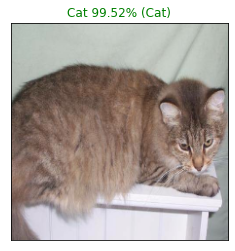

In [33]:
plot_pred(predictions, val_images, val_labels, n=777)

In [1]:
# Create a function to load the saved model
import tensorflow as tf
model_path = "models/20210812-193039-all-train-images.h5"
def load_model(model_path):
    model = tf.keras.models.load_model(model_path)
    return model

In [2]:
model = load_model(model_path)

In [3]:
model.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_17 (Conv2D)           (None, 222, 222, 32)      896       
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 111, 111, 32)      0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 109, 109, 32)      9248      
_________________________________________________________________
max_pooling2d_18 (MaxPooling (None, 54, 54, 32)        0         
_________________________________________________________________
flatten_8 (Flatten)          (None, 93312)             0         
_________________________________________________________________
dense_16 (Dense)             (None, 128)               11944064  
_________________________________________________________________
dense_17 (Dense)             (None, 1)                

In [34]:
model.evaluate(valid_data)

50/50 [==============================] - 34s 614ms/step - loss: 0.4157 - accuracy: 0.9444


[0.41572991013526917, 0.9443749785423279]

In [59]:
model.evaluate(train_data)

200/200 [==============================] - 475s 2s/step - loss: 0.4679 - accuracy: 0.9314


[0.46785682439804077, 0.9314062595367432]

In [35]:
# Let us try to find out the number of labels that do not match
c = 0
for i in range(1600):
    pred = get_pred_label(predictions[i])
    if pred != val_labels[i]:
        c +=1
#         print(i)
print(c)

89


In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [7]:
import os
dogs_cats = os.listdir("test_set/dogs_cats")

In [8]:
test_labels = pd.DataFrame(dogs_cats, columns=['filename'])
test_labels = test_labels.sample(frac=1)

In [9]:
test_labels['label'] = test_labels['filename'].map(lambda x: x[:3])

In [10]:
test_filenames = ["test_set/dogs_cats/" + fname for fname in test_labels['filename']]
test_filenames[:5]

['test_set/dogs_cats/cat.4415.jpg',
 'test_set/dogs_cats/cat.4877.jpg',
 'test_set/dogs_cats/dog.4359.jpg',
 'test_set/dogs_cats/cat.4878.jpg',
 'test_set/dogs_cats/cat.4272.jpg']

In [19]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test batches...


In [20]:
test_predictions = model.predict(test_data, verbose=1)

63/63 [==============================] - 90s 1s/step


In [21]:
# Let us create a function to unbatchify the test data
def unbatchify_test_data(data):
    images = []
    for image in data.unbatch().as_numpy_iterator():
        images.append(image)
    return images

In [22]:
test_images = unbatchify_test_data(test_data)

In [23]:
# Create a function to conver the image array to actual images with the predicted label on top
def plot_test_image(predictions, images, n=1):
    test_prob, image = predictions[n], images[n]
    test_pred = get_pred_label(test_prob)
    
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    
    plt.title(get_label_name(test_pred),fontsize=15)

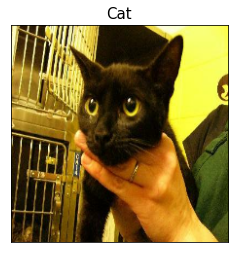

In [26]:
plot_test_image(test_predictions, test_images, n=592)

In [27]:
import random
# Let us create a function to plot multiple images randomly and check.
def show_25_random_imgs(predictions, images, n_rows=5,n_cols=5):
    plt.figure(figsize=(n_cols*5, n_rows*5))
    for i in range(n_rows*n_cols):
        plt.subplot(n_rows, n_cols, i+1)
        plot_test_image(predictions, images, n=np.random.randint(0,2000))

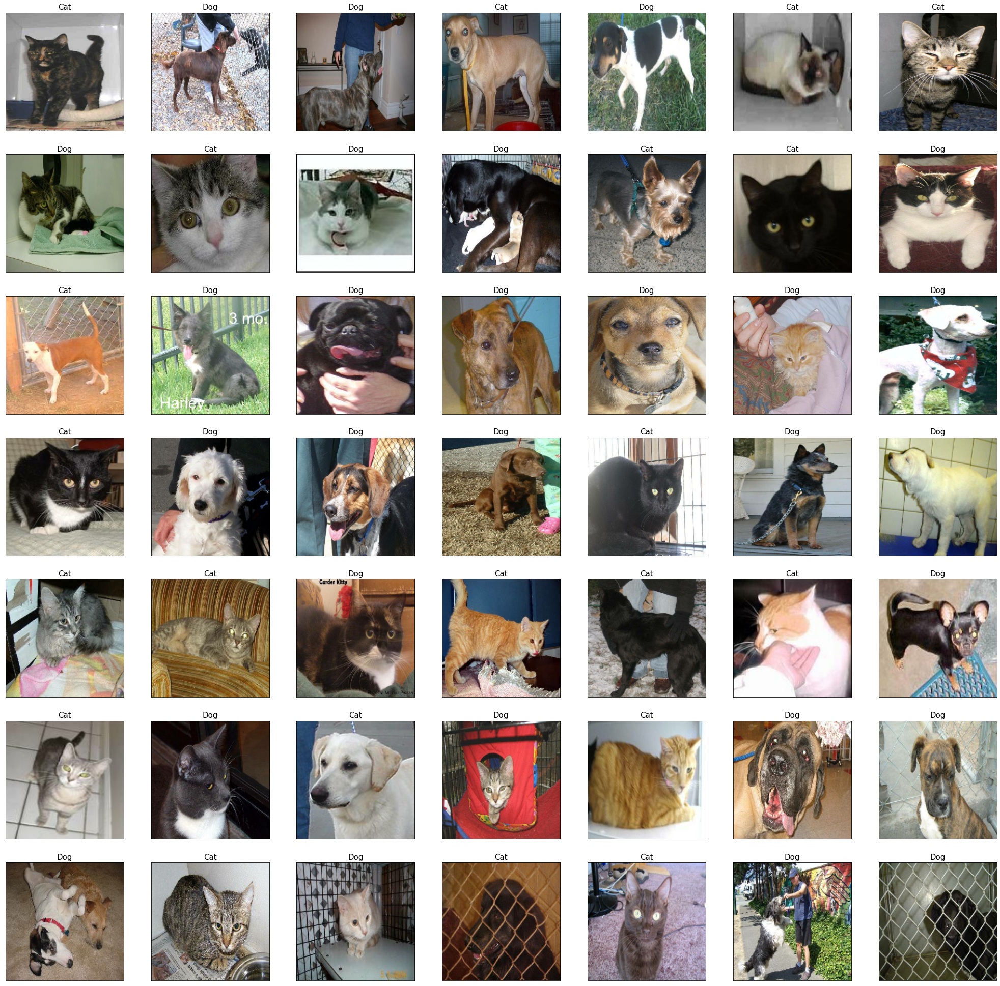

In [47]:
show_25_random_imgs(test_predictions, test_images, 7, 7)

In [28]:
# Let us try to create a confusion matrix for the test_data predictions.
# We need to first get the actual predictions
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

test_actual_labels = le.fit_transform(test_labels['label'])

In [29]:
test_pred_labels = [get_pred_label(label) for label in test_predictions]
test_pred_labels = np.array(test_pred_labels)

In [30]:
# Confusion matrix
from sklearn.metrics import confusion_matrix, classification_report
cm = confusion_matrix(test_actual_labels, test_pred_labels)
cr = classification_report(test_actual_labels, test_pred_labels)

print(cm)
print(cr)

[[573 427]
 [218 782]]
              precision    recall  f1-score   support

           0       0.72      0.57      0.64      1000
           1       0.65      0.78      0.71      1000

    accuracy                           0.68      2000
   macro avg       0.69      0.68      0.67      2000
weighted avg       0.69      0.68      0.67      2000



In [31]:
# let us create validation batch using the test data so that we can evaluate the performance
test_data_val = create_data_batches(test_filenames, test_actual_labels, valid_data=True)

Creating Validation batches...


In [52]:
model.evaluate(test_data_val)

63/63 [==============================] - 58s 788ms/step - loss: 2.3187 - accuracy: 0.6775


[2.318727970123291, 0.6775000095367432]

In [34]:
test_val_images, test_val_labels = unbatchify(test_data_val)

In [35]:
# Create a function to show random test images with predicted labels
def show_rand_imgs_pred(predictions, images, labels, n_rows=5, n_cols=5):
    plt.figure(figsize=(5*n_cols, 5*n_rows))
    for i in range(n_rows*n_cols):
        plt.subplot(n_rows, n_cols, i+1)
        plot_pred(predictions, images, labels, n=np.random.randint(0,2000))

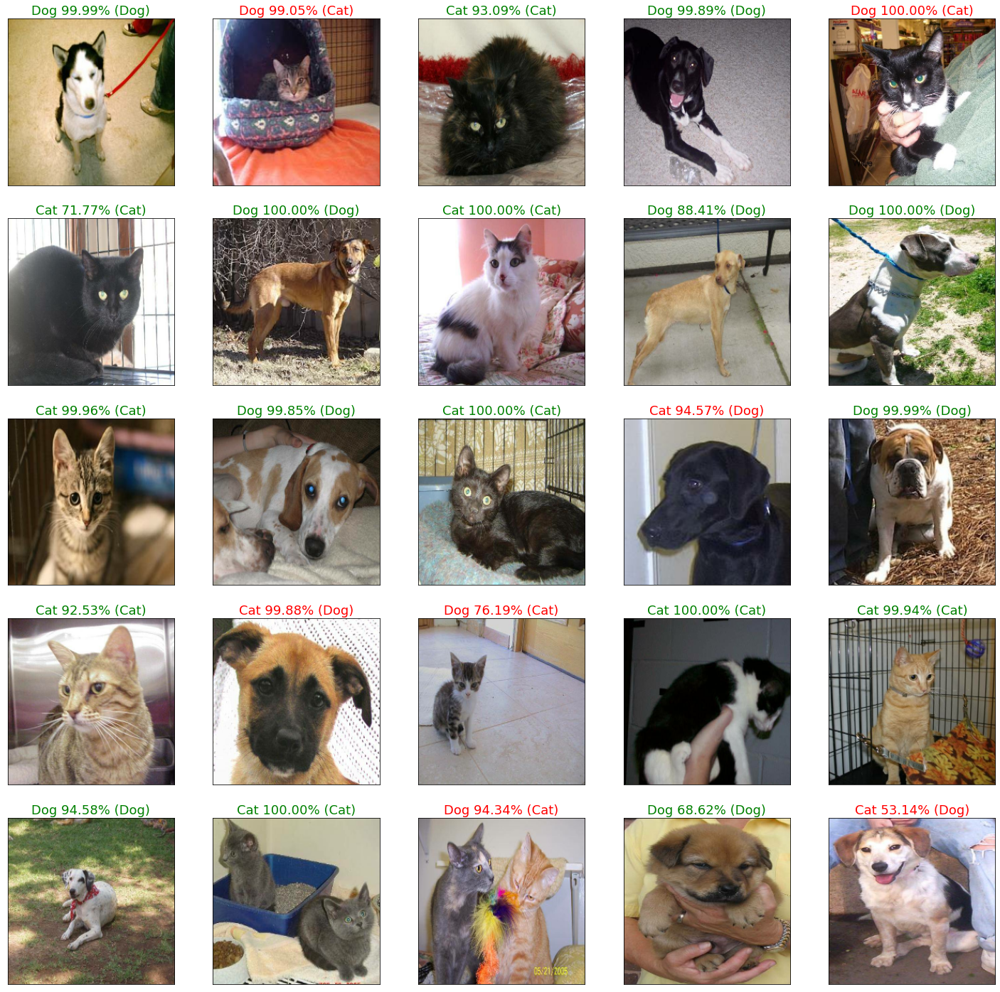

In [38]:
show_rand_imgs_pred(test_predictions, test_val_images, test_val_labels)

In [63]:
test_actual_labels, test_pred_labels

(array([0, 1, 1, ..., 1, 0, 0]), array([0, 1, 1, ..., 1, 0, 1]))

In [74]:
test_filenames_ar = np.array(test_filenames)

In [77]:
d = 1; c = 0
d_d = test_filenames_ar[(test_actual_labels == d) & (test_pred_labels == d)]
d_c = test_filenames_ar[(test_actual_labels == d) & (test_pred_labels == c)]
c_c = test_filenames_ar[(test_actual_labels == c) & (test_pred_labels == c)]
c_d = test_filenames_ar[(test_actual_labels == c) & (test_pred_labels == d)]

In [86]:
test_images_arr = np.array(test_images)

In [ ]:
d = 1; c = 0
d_d = test_images_arr[(test_actual_labels == d) & (test_pred_labels == d)]
d_c = test_images_arr[(test_actual_labels == d) & (test_pred_labels == c)]
c_c = test_images_arr[(test_actual_labels == c) & (test_pred_labels == c)]
c_d = test_images_arr[(test_actual_labels == c) & (test_pred_labels == d)]